In [1]:
import shutil
import pandas as pd
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import torch
import copy
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
import torch.nn.functional as F
from lime import lime_image
from utils import cam_viz
import time
from lime import lime_image
from skimage.segmentation import mark_boundaries

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [2]:
model_densenet = torch.load('models/model_densenet121_88.6%.pt', map_location=torch.device('cuda'))
model_densenet.eval()
model_resnet = torch.load('models/resnet101_2_wide_model_87.6%.pt', map_location=torch.device('cuda'))
model_resnet.eval()
model_mobilenet = torch.load('models/mobilenet_v3_large_model_79.35%.pt', map_location=torch.device('cuda'))
model_mobilenet.eval();
model_densenet_cutmix = torch.load('models/model_densenet121_cutmix_mixup_88.4%.pt', map_location=torch.device('cuda'))
model_densenet_cutmix.eval();

In [3]:
data_means = [0.485, 0.456, 0.406]
data_stds = [0.229, 0.224, 0.225]

# Note that we do not normalize the images in the transforms to make it easier to get the unnormalized and
# normalized images later.
data_transforms = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
])

In [4]:
batch_size = 16
num_workers = 2
data_dir = 'images_sep_2'

dataset_test = datasets.ImageFolder(os.path.join(data_dir, 'test'), transform=data_transforms)

dataset_size = len(dataset_test)
class_names = dataset_test.classes

In [5]:
# Transform to resize a PIL image and turn it into a tensor.
pil_to_tensor_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

normalize_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

def batchPredictDensenet(images: np.ndarray) -> np.ndarray:
    """Pass a batch of numpy array images through a PyTorch neural network and return the model's predictions.

    Args:
        images (np.ndarray): A batch of numpy array images. Has the dimensions B x H x W x C

    Returns:
        np.ndarray: The predictions from the model for each image in `images`. This is an array with dimensions
                    (number of images in batch) x (number of classes).
    """
    model_densenet.eval()

    images = tuple(normalize_transform(i) for i in images)
    batch = torch.stack(images, dim=0).float()

    model_densenet.to(device)
    batch = batch.to(device)

    logits = model_densenet(batch)
    probabilities = F.softmax(logits, dim=1)

    return probabilities.detach().cpu().numpy()

def batchPredictResnet(images: np.ndarray) -> np.ndarray:
    """Pass a batch of numpy array images through a PyTorch neural network and return the model's predictions.

    Args:
        images (np.ndarray): A batch of numpy array images. Has the dimensions B x H x W x C

    Returns:
        np.ndarray: The predictions from the model for each image in `images`. This is an array with dimensions
                    (number of images in batch) x (number of classes).
    """
    model_resnet.eval()

    images = tuple(normalize_transform(i) for i in images)
    batch = torch.stack(images, dim=0).float()

    model_resnet.to(device)
    batch = batch.to(device)

    logits = model_resnet(batch)
    probabilities = F.softmax(logits, dim=1)

    return probabilities.detach().cpu().numpy()

def batchPredictMobilenet(images: np.ndarray) -> np.ndarray:
    """Pass a batch of numpy array images through a PyTorch neural network and return the model's predictions.

    Args:
        images (np.ndarray): A batch of numpy array images. Has the dimensions B x H x W x C

    Returns:
        np.ndarray: The predictions from the model for each image in `images`. This is an array with dimensions
                    (number of images in batch) x (number of classes).
    """
    model_mobilenet.eval()

    images = tuple(normalize_transform(i) for i in images)
    batch = torch.stack(images, dim=0).float()

    model_mobilenet.to(device)
    batch = batch.to(device)

    logits = model_mobilenet(batch)
    probabilities = F.softmax(logits, dim=1)

    return probabilities.detach().cpu().numpy()

def batchPredictDensenetCutmix(images: np.ndarray) -> np.ndarray:
    """Pass a batch of numpy array images through a PyTorch neural network and return the model's predictions.

    Args:
        images (np.ndarray): A batch of numpy array images. Has the dimensions B x H x W x C

    Returns:
        np.ndarray: The predictions from the model for each image in `images`. This is an array with dimensions
                    (number of images in batch) x (number of classes).
    """
    model_densenet_cutmix.eval()

    images = tuple(normalize_transform(i) for i in images)
    batch = torch.stack(images, dim=0).float()

    model_densenet_cutmix.to(device)
    batch = batch.to(device)

    logits = model_densenet_cutmix(batch)
    probabilities = F.softmax(logits, dim=1)

    return probabilities.detach().cpu().numpy()

In [6]:
num_samples = 200

pil_resize_transform = transforms.Compose([
    transforms.Resize((256, 256)),
])

data_transforms_full = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(data_means, data_stds)
])

dataset_test_lime = datasets.ImageFolder(os.path.join(data_dir, 'test'), transform=pil_resize_transform)

In [51]:


def visualise_lime(i):

    """Visulise lime and save it to val_image_lime/"""
    image_pil, label = dataset_test_lime[i]
    actual_wound_type = class_names[label]
    preprocessed_image = data_transforms_full(image_pil).unsqueeze(0)
    preprocessed_image = preprocessed_image.to(device)

    explainer = lime_image.LimeImageExplainer()

    fig, ax = plt.subplots(2, 5, figsize=(20, 10),constrained_layout=True)
    ax[0,0].imshow(image_pil)
    ax[0,0].set_title(actual_wound_type)

    # # DenseNet LIME Explanation.
    explanation = explainer.explain_instance(
        np.array(image_pil),
        batchPredictDensenet,
        top_labels=1,
        hide_color=0,
        num_samples=num_samples,
    )
    prediction = class_names[model_densenet(preprocessed_image).argmax().item()]

    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        num_features=15,
        hide_rest=False,
    )
    img_boundry = mark_boundaries(temp / 255.0, mask)
    ax[0,1].imshow(img_boundry)
    ax[0,1].set_title(f'LIME DenseNet: {prediction}')

    # # DenseNetCutMix LIME Explanation.
    explanation = explainer.explain_instance(
        np.array(image_pil),
        batchPredictDensenetCutmix,
        top_labels=1,
        hide_color=0,
        num_samples=num_samples,
    )
    prediction = class_names[model_densenet_cutmix(preprocessed_image).argmax().item()]

    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        num_features=15,
        hide_rest=False,
    )
    img_boundry = mark_boundaries(temp / 255.0, mask)
    ax[0,2].imshow(img_boundry)
    ax[0,2].set_title(f'LIME DenseNetCutMix: {prediction}')

    # # Resnet LIME Explanation.
    explanation = explainer.explain_instance(
        np.array(image_pil),
        batchPredictResnet,
        top_labels=1,
        hide_color=0,
        num_samples=num_samples,
    )
    prediction = class_names[model_resnet(preprocessed_image).argmax().item()]

    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        num_features=15,
        hide_rest=False,
    )
    img_boundry = mark_boundaries(temp / 255.0, mask)
    ax[0,3].set_title(f'LIME Resnet: {prediction}')
    ax[0,3].imshow(img_boundry)

    # Mobilenet LIME Explanation
    explanation = explainer.explain_instance(
        np.array(image_pil),
        batchPredictMobilenet,
        top_labels=1,
        hide_color=0,
        num_samples=num_samples,
    )
    prediction = class_names[model_mobilenet(preprocessed_image).argmax().item()]

    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        num_features=15,
        hide_rest=False,
    )
    img_boundry = mark_boundaries(temp / 255.0, mask)
    ax[0,4].set_title(f'LIME Mobilenet: {prediction}')
    ax[0,4].imshow(img_boundry)

    ax[0,0].axis('off')
    ax[0,1].axis('off')
    ax[0,2].axis('off')
    ax[0,3].axis('off')
    ax[0,4].axis('off')

    image_tensor, label_tensor = dataset_test[i]
    image_array = image_tensor.numpy().transpose(1, 2, 0)

    visualization_densenet, preds_densenet = cam_viz(model_densenet,model_densenet[0].features.denseblock4.denselayer16.conv2,
    image_tensor, label_tensor, data_means, data_stds,device)

    visualization_densenet_cutmix, preds_densenet_cutmix = cam_viz(model_densenet_cutmix,model_densenet_cutmix[0].features.denseblock4.denselayer16.conv2,
    image_tensor, label_tensor, data_means, data_stds,device)

    visualization_resnet, preds_resnet = cam_viz(model_resnet,model_resnet[0].layer4[2].conv3,
    image_tensor, label_tensor, data_means, data_stds,device)

    visualization_mobilenet, preds_mobilenet = cam_viz(model_mobilenet,model_mobilenet[0].features[16][0],
    image_tensor, label_tensor, data_means, data_stds,device)
        
    
    ax[1,0].imshow(image_array)
    ax[1,1].imshow(visualization_densenet)
    ax[1,2].imshow(visualization_densenet_cutmix)
    ax[1,3].imshow(visualization_resnet)
    ax[1,4].imshow(visualization_mobilenet)
    ax[1,0].title.set_text(f"{class_names[label_tensor]}")
    ax[1,1].title.set_text(f"GradCam Densenet: {class_names[preds_densenet]}")
    ax[1,2].title.set_text(f"GradCam DensenetCutMix: {class_names[preds_densenet]}")
    ax[1,3].title.set_text(f"GradCam Resnet: {class_names[preds_resnet]}")
    ax[1,4].title.set_text(f"GradCam Mobilenet: {class_names[preds_mobilenet]}")
    ax[1,0].axis('off')
    ax[1,1].axis('off')
    ax[1,2].axis('off')
    ax[1,3].axis('off')
    ax[1,4].axis('off')

    fig.savefig(f"final_output/{i}-{class_names[label_tensor]}")


In [ ]:
for i in range(0,513):
    visualise_lime(i)
    


In [7]:
dataset_test = datasets.ImageFolder(os.path.join(data_dir, 'val'), transform=data_transforms)
dataset_test_lime = datasets.ImageFolder(os.path.join(data_dir, 'val'), transform=pil_resize_transform)

In [19]:
def visualise_lime(i):

    """Visulise lime and save it to val_image_lime/"""
    image_pil, label = dataset_test_lime[i]
    actual_wound_type = class_names[label]
    preprocessed_image = data_transforms_full(image_pil).unsqueeze(0)
    preprocessed_image = preprocessed_image.to(device)

    explainer = lime_image.LimeImageExplainer()

    fig, ax = plt.subplots(2, 5, figsize=(20, 10),constrained_layout=True)
    ax[0,0].imshow(image_pil)
    ax[0,0].set_title(actual_wound_type)

    # # DenseNet LIME Explanation.
    explanation = explainer.explain_instance(
        np.array(image_pil),
        batchPredictDensenet,
        top_labels=1,
        hide_color=0,
        num_samples=num_samples,
    )
    prediction = class_names[model_densenet(preprocessed_image).argmax().item()]

    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        num_features=15,
        hide_rest=False,
    )
    img_boundry = mark_boundaries(temp / 255.0, mask)
    ax[0,1].imshow(img_boundry)
    ax[0,1].set_title(f'LIME DenseNet: {prediction}')

    # # DenseNetCutMix LIME Explanation.
    explanation = explainer.explain_instance(
        np.array(image_pil),
        batchPredictDensenetCutmix,
        top_labels=1,
        hide_color=0,
        num_samples=num_samples,
    )
    prediction = class_names[model_densenet_cutmix(preprocessed_image).argmax().item()]

    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        num_features=15,
        hide_rest=False,
    )
    img_boundry = mark_boundaries(temp / 255.0, mask)
    ax[0,2].imshow(img_boundry)
    ax[0,2].set_title(f'LIME DenseNetCutMix: {prediction}')

    # # Resnet LIME Explanation.
    explanation = explainer.explain_instance(
        np.array(image_pil),
        batchPredictResnet,
        top_labels=1,
        hide_color=0,
        num_samples=num_samples,
    )
    prediction = class_names[model_resnet(preprocessed_image).argmax().item()]

    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        num_features=15,
        hide_rest=False,
    )
    img_boundry = mark_boundaries(temp / 255.0, mask)
    ax[0,3].set_title(f'LIME Resnet: {prediction}')
    ax[0,3].imshow(img_boundry)

    # Mobilenet LIME Explanation
    explanation = explainer.explain_instance(
        np.array(image_pil),
        batchPredictMobilenet,
        top_labels=1,
        hide_color=0,
        num_samples=num_samples,
    )
    prediction = class_names[model_mobilenet(preprocessed_image).argmax().item()]

    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        num_features=15,
        hide_rest=False,
    )
    img_boundry = mark_boundaries(temp / 255.0, mask)
    ax[0,4].set_title(f'LIME Mobilenet: {prediction}')
    ax[0,4].imshow(img_boundry)

    ax[0,0].axis('off')
    ax[0,1].axis('off')
    ax[0,2].axis('off')
    ax[0,3].axis('off')
    ax[0,4].axis('off')

    image_tensor, label_tensor = dataset_test[i]
    image_array = image_tensor.numpy().transpose(1, 2, 0)

    visualization_densenet, preds_densenet = cam_viz(model_densenet,model_densenet[0].features.denseblock4.denselayer16.conv2,
    image_tensor, label_tensor, data_means, data_stds,device)

    visualization_densenet_cutmix, preds_densenet_cutmix = cam_viz(model_densenet_cutmix,model_densenet_cutmix[0].features.denseblock4.denselayer16.conv2,
    image_tensor, label_tensor, data_means, data_stds,device)

    visualization_resnet, preds_resnet = cam_viz(model_resnet,model_resnet[0].layer4[2].conv3,
    image_tensor, label_tensor, data_means, data_stds,device)

    visualization_mobilenet, preds_mobilenet = cam_viz(model_mobilenet,model_mobilenet[0].features[16][0],
    image_tensor, label_tensor, data_means, data_stds,device)
        
    
    ax[1,0].imshow(image_array)
    ax[1,1].imshow(visualization_densenet)
    ax[1,2].imshow(visualization_densenet_cutmix)
    ax[1,3].imshow(visualization_resnet)
    ax[1,4].imshow(visualization_mobilenet)
    ax[1,0].title.set_text(f"{class_names[label_tensor]}")
    ax[1,1].title.set_text(f"GradCam Densenet: {class_names[preds_densenet]}")
    ax[1,2].title.set_text(f"GradCam DensenetCutMix: {class_names[preds_densenet]}")
    ax[1,3].title.set_text(f"GradCam Resnet: {class_names[preds_resnet]}")
    ax[1,4].title.set_text(f"GradCam Mobilenet: {class_names[preds_mobilenet]}")
    ax[1,0].axis('off')
    ax[1,1].axis('off')
    ax[1,2].axis('off')
    ax[1,3].axis('off')
    ax[1,4].axis('off')
    fig.savefig(f"final_output/val_data_{i}-{class_names[label_tensor]}")


100%|██████████| 200/200 [00:00<00:00, 208.10it/s]
<ipython-input-19-3bbb685ce020>:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(2, 5, figsize=(20, 10),constrained_layout=True)
100%|██████████| 200/200 [00:01<00:00, 198.43it/s]


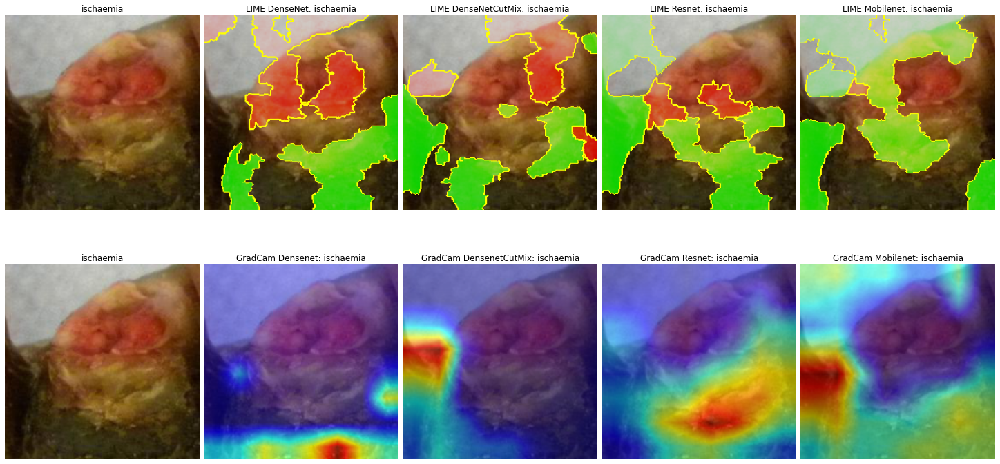

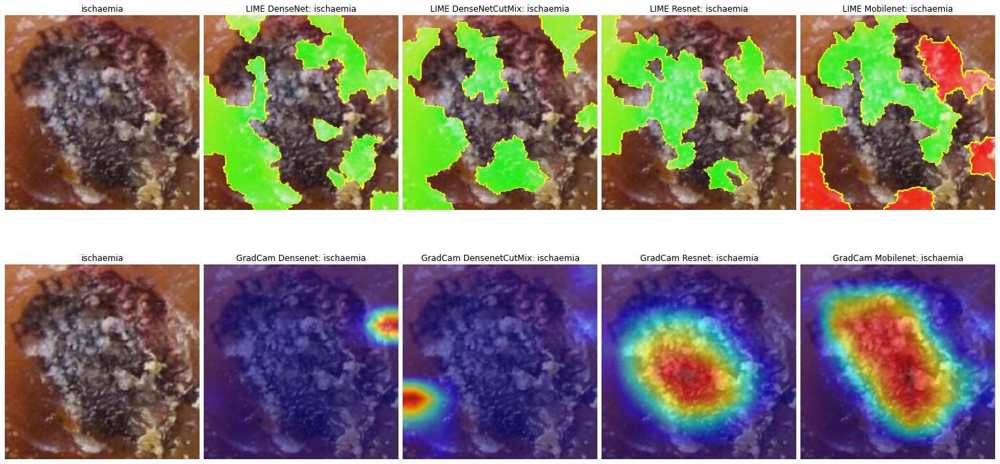

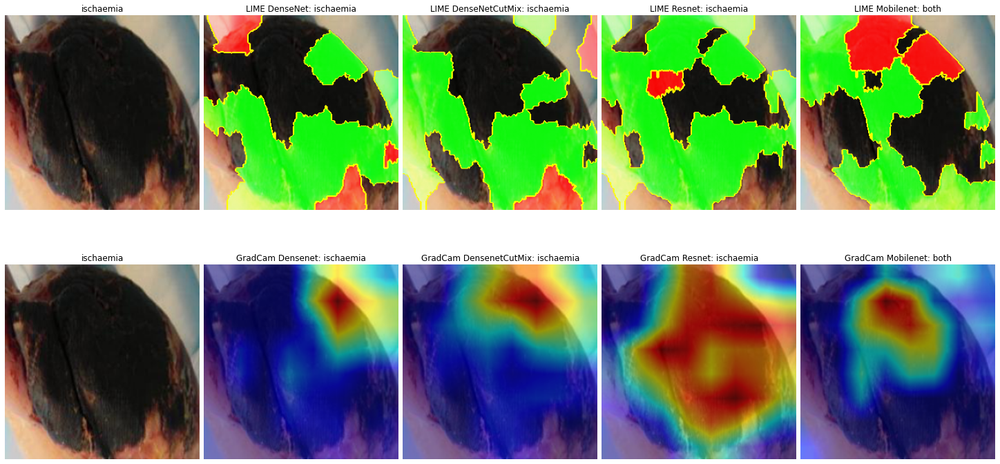

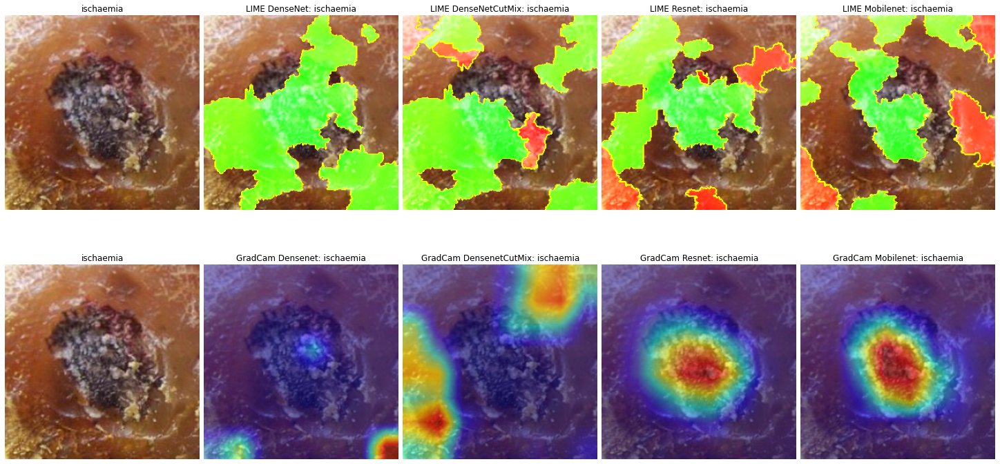

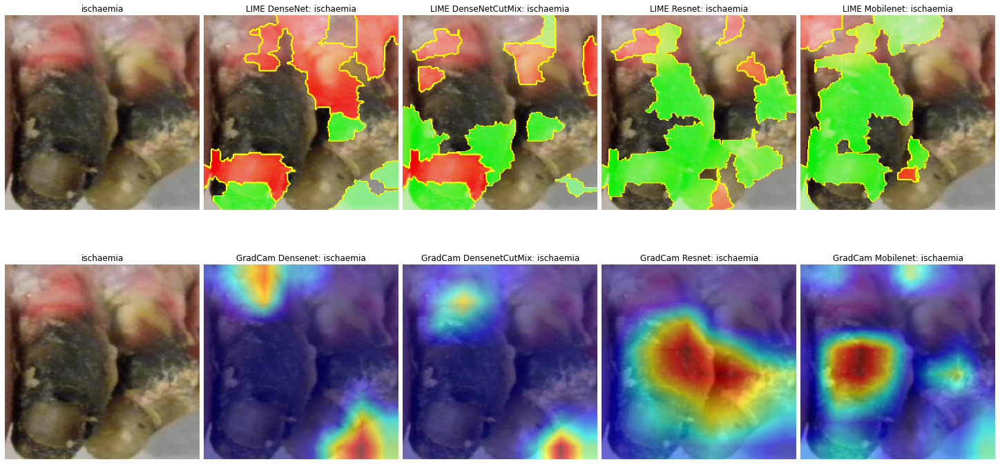

...

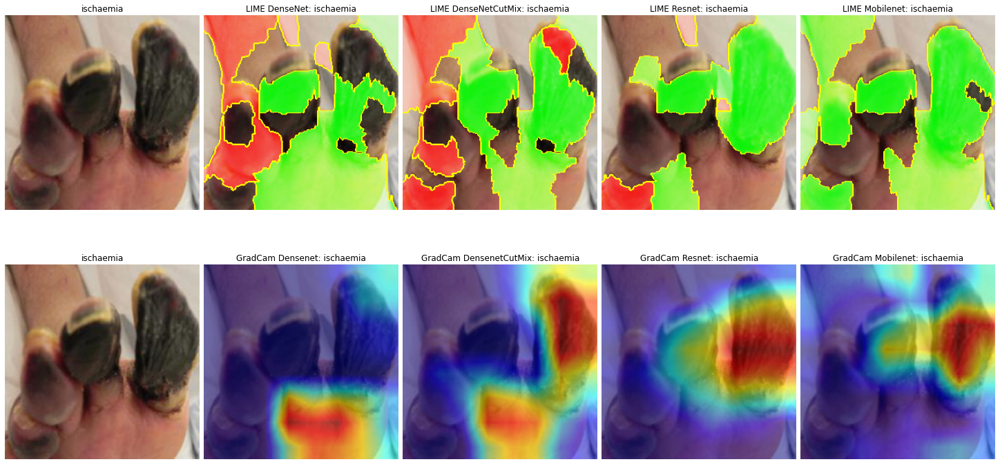

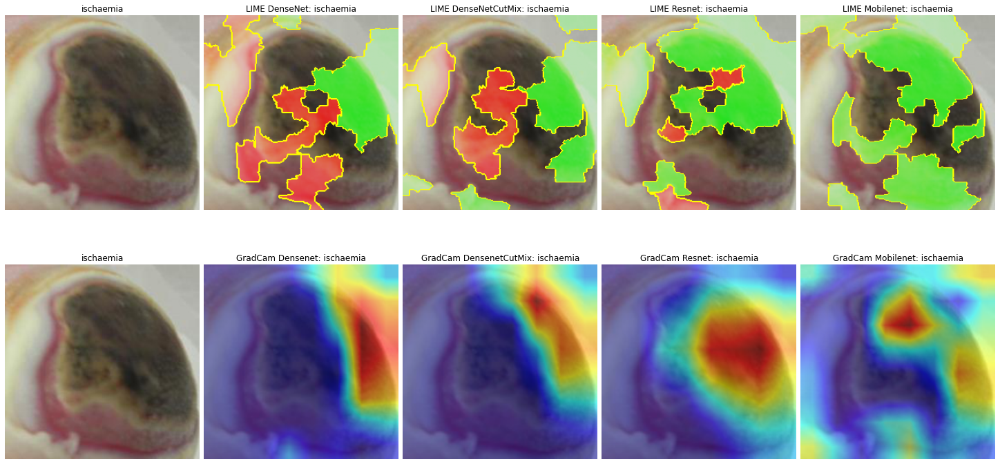

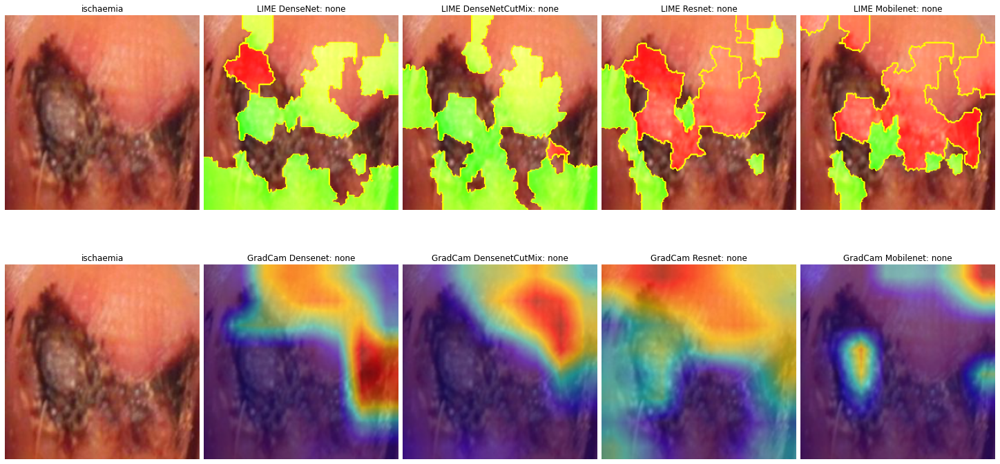

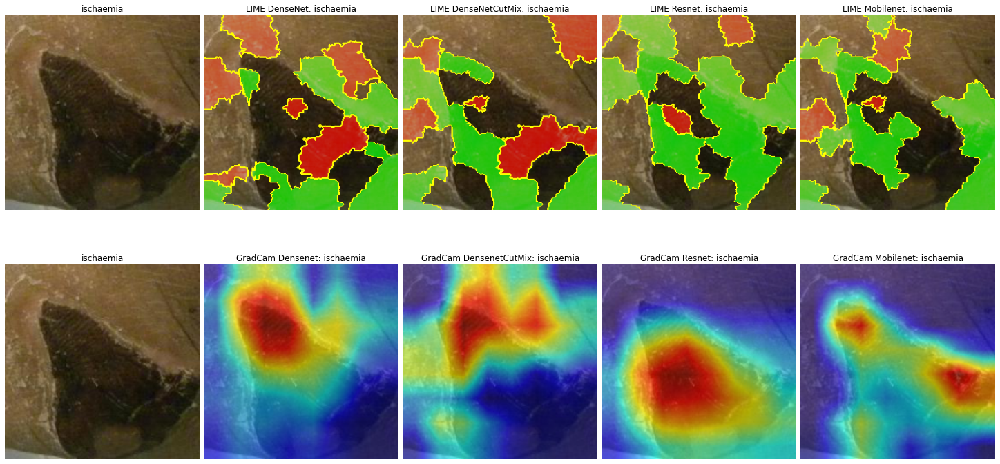

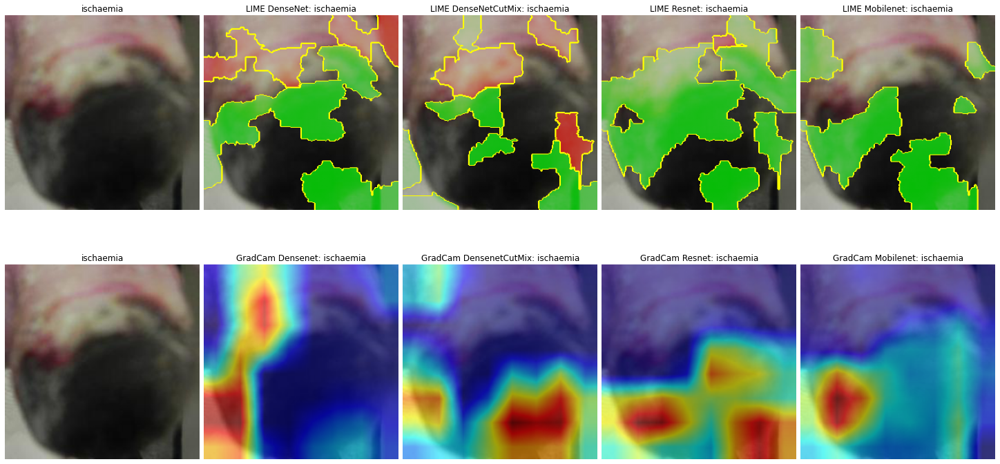

In [20]:
for i in range(476,510):
    visualise_lime(i)